# 1. Identitas

* Nama : Muhammad Itsar Rabbani
* Batch : 006
* Phase 01 Milestone 2
* Notebook Objective :
  * Membuat model supervised learning untuk memprediksi customer yang ada di masa mendatang melalui parameter yang ada, apakah akan Churn atau tidak
  * Membuat Customer Segmentation menggunakan Unsupervised Learning, dalam hal ini adalah K-Means untuk keperluan strategi dan kampanye marketing

* Dataset from : https://www.kaggle.com/ankitverma2010/ecommerce-customer-churn-analysis-and-prediction

# 2. Import Pustaka

In [ ]:
!pip install dataprep

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns

#pip install dataprep
from dataprep.eda import create_report

#Data Pre-pr
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

#Supervised Model
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix, classification_report

#Unsupervised Model
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score


import warnings
warnings.filterwarnings('ignore')

# 3. Data Load

###Import w/ Kaggle

In [ ]:
#permission access kaggle to root
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle

In [ ]:
#kaggle on default folder
!mkdir ./kaggle
!mv ./kaggle.json /kaggle

In [ ]:
#granting access permission
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
#download dataset
!kaggle datasets download -d ankitverma2010/ecommerce-customer-churn-analysis-and-prediction
!mkdir churn
!unzip ecommerce-customer-churn-analysis-and-prediction.zip -d churn

  0% 0.00/532k [00:00<?, ?B/s]
100% 532k/532k [00:00<00:00, 38.1MB/s]
Archive:  ecommerce-customer-churn-analysis-and-prediction.zip
  inflating: churn/E Commerce Dataset.xlsx  


# Data Load

In [ ]:
df = pd.read_excel('/content/churn/E Commerce Dataset.xlsx', sheet_name='E Comm')
df.head()

,CustomerID,Churn,Tenure,PreferredLoginDevice,CityTier,WarehouseToHome,PreferredPaymentMode,Gender,HourSpendOnApp,NumberOfDeviceRegistered,PreferedOrderCat,SatisfactionScore,MaritalStatus,NumberOfAddress,Complain,OrderAmountHikeFromlastYear,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount
0,50001,1,4.0,Mobile Phone,3,6.0,Debit Card,Female,3.0,3,Laptop & Accessory,2,Single,9,1,11.0,1.0,1.0,5.0,159.93
1,50002,1,NaN,Phone,1,8.0,UPI,Male,3.0,4,Mobile,3,Single,7,1,15.0,0.0,1.0,0.0,120.90
2,50003,1,NaN,Phone,1,30.0,Debit Card,Male,2.0,4,Mobile,3,Single,6,1,14.0,0.0,1.0,3.0,120.28
3,50004,1,0.0,Phone,3,15.0,Debit Card,Male,2.0,4,Laptop & Accessory,5,Single,8,0,23.0,0.0,1.0,3.0,134.07
4,50005,1,0.0,Phone,1,12.0,CC,Male,NaN,3,Mobile,5,Single,3,0,11.0,1.0,1.0,3.0,129.60


In [ ]:
#dataset dimension
df.shape

(5630, 20)

In [ ]:
#basic info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5630 entries, 0 to 5629
Data columns (total 20 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   5630 non-null   int64  
 1   Churn                        5630 non-null   int64  
 2   Tenure                       5366 non-null   float64
 3   PreferredLoginDevice         5630 non-null   object 
 4   CityTier                     5630 non-null   int64  
 5   WarehouseToHome              5379 non-null   float64
 6   PreferredPaymentMode         5630 non-null   object 
 7   Gender                       5630 non-null   object 
 8   HourSpendOnApp               5375 non-null   float64
 9   NumberOfDeviceRegistered     5630 non-null   int64  
 10  PreferedOrderCat             5630 non-null   object 
 11  SatisfactionScore            5630 non-null   int64  
 12  MaritalStatus                5630 non-null   object 
 13  NumberOfAddress   

# 4. Data Cleaning

In [ ]:
df.isnull().sum()

CustomerID                       0
Churn                            0
Tenure                         264
PreferredLoginDevice             0
CityTier                         0
WarehouseToHome                251
PreferredPaymentMode             0
Gender                           0
HourSpendOnApp                 255
NumberOfDeviceRegistered         0
PreferedOrderCat                 0
SatisfactionScore                0
MaritalStatus                    0
NumberOfAddress                  0
Complain                         0
OrderAmountHikeFromlastYear    265
CouponUsed                     256
OrderCount                     258
DaySinceLastOrder              307
CashbackAmount                   0
dtype: int64

Secara default saya akan men-drop kolom CustomerID karena tidak berpengaruh apapun terhadap modelling. Selanjutnya karena ada sejumlah missing values, saya akan mencoba melihat dulu komposisi kolom tersebut untuk kemudian dilakukan keputusan apakah akan langsung didrop atau mau dilakukan handling

In [ ]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
CustomerID,5630.0,52815.500000,1625.385339,50001.0,51408.25,52815.50,54222.7500,55630.00
Churn,5630.0,0.168384,0.374240,0.0,0.00,0.00,0.0000,1.00
Tenure,5366.0,10.189899,8.557241,0.0,2.00,9.00,16.0000,61.00
CityTier,5630.0,1.654707,0.915389,1.0,1.00,1.00,3.0000,3.00
WarehouseToHome,5379.0,15.639896,8.531475,5.0,9.00,14.00,20.0000,127.00
HourSpendOnApp,5375.0,2.931535,0.721926,0.0,2.00,3.00,3.0000,5.00
NumberOfDeviceRegistered,5630.0,3.688988,1.023999,1.0,3.00,4.00,4.0000,6.00
SatisfactionScore,5630.0,3.066785,1.380194,1.0,2.00,3.00,4.0000,5.00
NumberOfAddress,5630.0,4.214032,2.583586,1.0,2.00,3.00,6.0000,22.00
Complain,5630.0,0.284902,0.451408,0.0,0.00,0.00,1.0000,1.00


In [ ]:
#Ratio NaN Values
for i in df.columns:
  if df[i].isnull().sum():
    print(i)
    print('Ratio NaN Values:', df[i].isnull().sum()*100/len(df))
    print('\n')

Tenure
Ratio NaN Values: 4.6891651865008885


WarehouseToHome
Ratio NaN Values: 4.458259325044405


HourSpendOnApp
Ratio NaN Values: 4.529307282415631


OrderAmountHikeFromlastYear
Ratio NaN Values: 4.706927175843695


CouponUsed
Ratio NaN Values: 4.547069271758437


OrderCount
Ratio NaN Values: 4.58259325044405


DaySinceLastOrder
Ratio NaN Values: 5.452930728241563




Berdasarkan hasil ratio, kolom yang terdapat missing values sebetulnya dapat didrop karena hanya mengisi kurang lebih 5% dari dataset.

Namun kita akan coba melihat dulu hasil dari modelling sederhana. Akurasi mana yang lebih besar, apakah lebih besar jika NaN values didrop atau diinput menggunakan median

## Model with Dropped NaN

In [ ]:
first = df.copy()
first.dropna(inplace=True)
first.drop('CustomerID', axis=1, inplace=True)
first.reset_index(drop=True, inplace=True)
first.head()

,Churn,Tenure,PreferredLoginDevice,CityTier,WarehouseToHome,PreferredPaymentMode,Gender,HourSpendOnApp,NumberOfDeviceRegistered,PreferedOrderCat,SatisfactionScore,MaritalStatus,NumberOfAddress,Complain,OrderAmountHikeFromlastYear,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount
0,1,4.0,Mobile Phone,3,6.0,Debit Card,Female,3.0,3,Laptop & Accessory,2,Single,9,1,11.0,1.0,1.0,5.0,159.93
1,1,0.0,Phone,3,15.0,Debit Card,Male,2.0,4,Laptop & Accessory,5,Single,8,0,23.0,0.0,1.0,3.0,134.07
2,1,0.0,Computer,1,22.0,Debit Card,Female,3.0,5,Mobile Phone,5,Single,2,1,22.0,4.0,6.0,7.0,139.19
3,1,11.0,Mobile Phone,1,6.0,Debit Card,Male,3.0,4,Fashion,3,Single,10,1,13.0,0.0,1.0,0.0,153.81
4,1,0.0,Phone,1,11.0,COD,Male,2.0,3,Mobile,3,Single,2,1,13.0,2.0,2.0,2.0,134.41


In [ ]:
#encoding
first_encoded = first.copy()
first_encoded = pd.get_dummies(first_encoded, drop_first=True)

In [ ]:
#DataSplit for Model which NaN Values was dropped

X_first = first_encoded.drop('Churn', axis=1)
y_first = first_encoded['Churn']

In [ ]:
#checking counts from target
first_encoded['Churn'].value_counts()

0    3143
1     631
Name: Churn, dtype: int64

In [ ]:
#train-test split
X1_train, X1_test, y1_train, y1_test = train_test_split(X_first, y_first, test_size=0.25, stratify=y_first)

#model
rf=RandomForestClassifier()
rf.fit(X1_train, y1_train)

#model performance
y1_pred = rf.predict(X1_test)
print(classification_report(y1_test, y1_pred))


              precision    recall  f1-score   support

           0       0.98      0.99      0.98       786
           1       0.94      0.88      0.91       158

    accuracy                           0.97       944
   macro avg       0.96      0.93      0.95       944
weighted avg       0.97      0.97      0.97       944



Karena kita mau menghindari False Negative (Mereka yang Churn tapi diprediksi tidak Churn). Maka kita akan mengambil hasil **Recall**. 

Dari classification report diatas dapat dilihat bahwa performa model menggunakan Random Forest dengan NaN values didrop mendapatkan hasil Recall sebesar 88%.

Lantas bagaimana performa model menggunakan Random Forest jika NaN diinput menggunakan median?

## Model with Median NaN

In [ ]:
second = df.copy()

#input NaN values
for i in second.columns:
    if second[i].isnull().sum():
        second[i].fillna(second[i].median(), inplace=True)

In [ ]:
#checkin again NaN values
second.isnull().sum()

CustomerID                     0
Churn                          0
Tenure                         0
PreferredLoginDevice           0
CityTier                       0
WarehouseToHome                0
PreferredPaymentMode           0
Gender                         0
HourSpendOnApp                 0
NumberOfDeviceRegistered       0
PreferedOrderCat               0
SatisfactionScore              0
MaritalStatus                  0
NumberOfAddress                0
Complain                       0
OrderAmountHikeFromlastYear    0
CouponUsed                     0
OrderCount                     0
DaySinceLastOrder              0
CashbackAmount                 0
dtype: int64

In [ ]:
#encoding
second_encoded = second.copy()
second_encoded = pd.get_dummies(second_encoded, drop_first=True)

In [ ]:
#DataSplit for Model which NaN Values was dropped

X_second = second_encoded.drop('Churn', axis=1)
y_second = second_encoded['Churn']

In [ ]:
#checking counts from target
second_encoded['Churn'].value_counts()

0    4682
1     948
Name: Churn, dtype: int64

In [ ]:
#train-test split
X2_train, X2_test, y2_train, y2_test = train_test_split(X_second, y_second, test_size=0.25, stratify=y_second)

#model
rf=RandomForestClassifier()
rf.fit(X2_train, y2_train)

#model performance
y2_pred = rf.predict(X2_test)
print(classification_report(y2_test, y2_pred))


              precision    recall  f1-score   support

           0       0.95      0.99      0.97      1171
           1       0.94      0.74      0.83       237

    accuracy                           0.95      1408
   macro avg       0.94      0.86      0.90      1408
weighted avg       0.95      0.95      0.94      1408



Melalui hasil akurasi model yang NaN nya diinput menggunakan nilai median mendapatkan hasil Recall yang berkurang yakni 74% jika dibandingkan dengan hasil Recall yang nilai NaN nya didrop mendapatkan hasil 88%.

Oleh karena itu untuk menyelesaikan tujuan dari notebook ini kita akan menggunakan data yang nilai NaN nya didrop.

# 5. Eksplorasi Data

In [ ]:
#first = dataset with dropped NaN
#first_encoded = encoded dataset with OneHot Encoding
#X_first = dataset features
#y_first = dataset target
#X1_train, X1_test, y1_train, y1_test = train-test split result with stratify

DataPrep Report
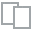
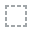
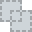
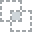
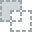
...
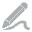
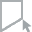
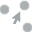
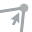
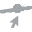

In [ ]:
#EDA using dataprep.eda
create_report(first)

Menggunakan fitur dataprep.eda kita dapat menemukan fakta-fakta bahwa :

1. Masih terdapat beberapa kolom yang memiliki data dengan nilai 0 cukup banyak. Misalnya :
  * Kolom Tenure, 303 data (8%)
  * Kolom Coupon Used, 610 data (16.20%)
  * Kolom Day Since Last Order, 207 data (5.5%)
  * Cashback Amount, 4 data (0.1%)
  
  Walau memang kolom day since last order dan cashback amount bisa saja karena memang mereka baru saja membeli barang dan tidak menggunakan kupon sehingga memiliki nilai 0. Namun untuk kolom Tenure dan kolom Coupon Used dicurigai dan harus dilakukan konfirmasi ke stakeholder terkait. 

2. Pada kolom Preferred Login Device, terdiri dari 
  * Mobile Phone : 1936 pengguna (51.30%)
  * Computer : 1111 Pengguna (29.44%)
  * Phone : 727 Pengguna (19.26%)

3. Pada kolom CityTier, terdiri dari
  * City Tier 1 : 2368 Pengguna (62.75%)
  * City Tier 2 : 141 Pengguna (3.74%)
  * City Tier 3 : 1265 Pengguna (33.52%)

4. Jarak dari Warehouse ke Rumah Customer rata-rata berjarak 14 miles

5. Pada kolom Pembayaran, terdiri dari
  * Debit Card : 1538 Pengguna (40.75%)
  * Credit Card : 1124 Pengguna (29.78%)
  * E-Wallet : 443 Pengguna (11.74%)
  * COD : 301 Pengguna (7.98%)
  * UPI : 285 Pengguna (7.55%)
  * Cash on Delivery : 48 Pengguna (1.27%)
  * CC : 35 Pengguna (0.93%)

6. Mayoritas pengguna merupakan :
  * Male, sebanyak 2271 Pengguna (60.17%)
  * Female, sebanyak 1503 Pengguna (39.83%)

7. Rata-rata penggunaan User sebanyak 3 jam

8. Mayoritas pengguna dari hasil rata-rata memiliki 4 jenis device dalam satu akun

9. Kategori yang memiliki order terbanyak :
  * Laptop & Acc : 1961 order (51.96%)
  * Mobile Phone : 1227 order (32.51%)
  * Fashion : 443 order (11.74%)
  * Mobile : 119 order (3.15%)
  * Grocery : 6 order (0.16%)

10. Tingkat kepuasan pelanggan secara berurut :
  * Bintang 3 : 1131 - 29.97%
  * Bintang 1 : 798 - 21.14%
  * Bintang 5 : 754 - 19.98%
  * Bintang 4 : 696 - 18.44%
  * Bintang 2 : 395 - 10.47%
  
11. Status Pelanggan secara berurut :
  * Married : 1952 Pengguna (52.52%)
  * Single : 1245 Pengguna (32.99%)
  * Divorced : 547 Pengguna (14.49%)

12. Jumlah Complain :
  * Tidak : 2709 Pengguna (71.78%)
  * Ya : 1065 Pengguna (28.22%)

# 6. Data Pre-Processing

In [ ]:
#first = dataset with dropped NaN
#first_encoded = encoded dataset with OneHot Encoding
#X_first = dataset features
#y_first = dataset target
#X1_train, X1_test, y1_train, y1_test = train-test split result with stratify

Sebagai pengingat, kita sebelumnya sudah pernah mencoba modelling pada Sub Data Cleaning. Namun untuk memudahkan dalam proses deploy model, kita akan mencoba menggunakan Pipelines. Oleh karena itu langkah pre-processing pada Sub ini akan diskip ke Sub Definition of Model.

# 7. Supervised Model

## Model Definition (Base Model)

In [ ]:
#define the pipe
scaler = StandardScaler()
clf1 = RandomForestClassifier()
clf2 = GradientBoostingClassifier()

#build pipeline 1
pipe1 = Pipeline([("scaler", scaler), ("rf", clf1)])

#build pipeline 2
pipe2 = Pipeline([("scaler", scaler), ("rf", clf2)])

## Model Training & Evaluation

In [ ]:
#fit pipeline 1 with RF Model
pipe1.fit(X1_train, y1_train)

Pipeline(steps=[('scaler', StandardScaler()), ('rf', RandomForestClassifier())])

In [ ]:
#score
print("Test score: {:.2f}".format(pipe1.score(X1_test, y1_test)))

Test score: 0.97


In [ ]:
#classification report for pipeline 1
pred_1 = pipe1.predict(X1_test)
print(classification_report(y1_test, pred_1))
print('\n')
print(confusion_matrix(y1_test, pred_1))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98       786
           1       0.94      0.86      0.90       158

    accuracy                           0.97       944
   macro avg       0.96      0.92      0.94       944
weighted avg       0.97      0.97      0.97       944



[[777   9]
 [ 22 136]]


In [ ]:
#fit pipeline 2 with GB Classifier Model
pipe2.fit(X1_train, y1_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('rf', GradientBoostingClassifier())])

In [ ]:
#score
print("Test score: {:.2f}".format(pipe2.score(X1_test, y1_test)))

Test score: 0.92


In [ ]:
#classification report for pipeline 2
pred_2 = pipe2.predict(X1_test)
print(classification_report(y1_test, pred_2))

              precision    recall  f1-score   support

           0       0.93      0.97      0.95       786
           1       0.83      0.65      0.73       158

    accuracy                           0.92       944
   macro avg       0.88      0.81      0.84       944
weighted avg       0.92      0.92      0.92       944



Dari kedua base model di atas, dapat dilihat dari basenya bahwa model terbaik secara umum maupun dari segi Recall jatuh kepada Random Forest Model. Maka untuk mendapatkan hasil terbaik kita akan mencoba melakukan hyperparameter kepada model tersebut

## Hyperparameter Model

### Finding Best Parameter

In [ ]:
param_grid = { 
    'rf__n_estimators': [10, 50, 100, 200],
    'rf__max_features': ['auto', 'sqrt', 'log2'],
    'rf__max_depth' : [4,5,6,7,8],
    'rf__criterion' :['gini', 'entropy']}

In [ ]:
#define pipeline
pipe = Pipeline([("scaler", StandardScaler()), ("rf", RandomForestClassifier())])

#using GridSearchCV
grid = GridSearchCV(pipe, param_grid=param_grid, cv=5)
grid.fit(X1_train, y1_train)

#Best Parameter
print("Best parameters: {}".format(grid.best_params_))

Best parameters: {'rf__criterion': 'entropy', 'rf__max_depth': 8, 'rf__max_features': 'sqrt', 'rf__n_estimators': 200}


### Model Best Parameter using Pipeline

In [ ]:
#define best model with pipeline
best_pipe = Pipeline([("scaler", StandardScaler()), ("rf", RandomForestClassifier(
    n_estimators=200, criterion='entropy', max_depth=8, max_features='sqrt'))])

#fit to train
best_pipe.fit(X1_train, y1_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('rf',
                 RandomForestClassifier(criterion='entropy', max_depth=8,
                                        max_features='sqrt',
                                        n_estimators=200))])

In [ ]:
#classification report for Best Model with Pipeline
pred = best_pipe.predict(X1_test)
print(classification_report(y1_test, pred))

              precision    recall  f1-score   support

           0       0.93      0.98      0.95       786
           1       0.86      0.63      0.73       158

    accuracy                           0.92       944
   macro avg       0.90      0.81      0.84       944
weighted avg       0.92      0.92      0.92       944



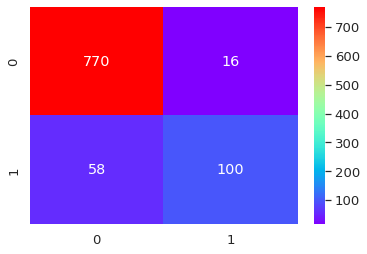

In [ ]:
#confusion matrix for Best Model with Pipeline
cm = confusion_matrix(y1_test, pred)

sns.set(font_scale = 1.2)
sns.heatmap(cm, annot = True,fmt = 'd', cmap='rainbow')

Yup ternyata sebaliknya. Model dengan menggunakan hyperparameter justru menghasilkan performa yang tidak lebih baik, bahkan turun dibandingkan hasil Base Model

Hyperparameter Model
* Recall : 63%
* True Positive : 100
* False Positive : 16
* True Negative : 770
* False Negative : 58

Sedangkan Base Model
* Recall : 86%
* True Positive : 136
* False Positive : 9
* True Negative : 777
* False Negative : 22

Maka untuk model yang akan dideploy, kita menggunakan pipeline yang base model, yakni **#pipe1**

# 8. Unsupervised Model (Customer Segmentation)

In [ ]:
#first = dataset with dropped NaN
#first_encoded = encoded dataset with OneHot Encoding
#X_first = dataset features
#y_first = dataset target

In [ ]:
#Scaling Dataset
scaler = StandardScaler()
scaled = scaler.fit_transform(X_first)

#convert
new = pd.DataFrame(scaled)
new.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28
0,-0.622195,1.379737,-1.133895,0.026054,-0.735644,-0.760276,1.867247,1.594886,-1.302577,-0.429832,-0.739840,0.140548,-0.177810,0.974361,-0.488462,-0.294395,-0.113501,-0.651269,1.205751,-0.364682,-0.285806,-1.229218,-0.039904,0.961524,-0.180439,-0.694077,-0.069227,-1.051678,1.425246
1,-1.143198,1.379737,-0.086554,-1.358868,0.239873,1.398703,1.476897,-0.627004,2.003728,-1.027101,-0.739840,-0.452772,-1.251250,-1.026313,2.047241,-0.294395,-0.113501,-0.651269,1.205751,-0.364682,-0.285806,0.813525,-0.039904,0.961524,-0.180439,-0.694077,-0.069227,-1.051678,1.425246
2,-1.143198,-0.755644,0.728045,0.026054,1.215390,1.398703,-0.865204,1.594886,1.728203,1.361977,1.286692,0.733868,-1.038721,-1.026313,-0.488462,-0.294395,-0.113501,-0.651269,1.205751,-0.364682,-0.285806,-1.229218,-0.039904,-1.040016,-0.180439,1.440762,-0.069227,-1.051678,1.425246
3,0.289561,-0.755644,-1.133895,0.026054,0.239873,-0.040617,2.257597,1.594886,-0.751526,-1.027101,-0.739840,-1.342752,-0.431850,0.974361,-0.488462,-0.294395,-0.113501,-0.651269,1.205751,-0.364682,-0.285806,0.813525,-0.039904,-1.040016,-0.180439,-0.694077,-0.069227,-1.051678,1.425246
4,-1.143198,-0.755644,-0.552039,-1.358868,-0.735644,-0.040617,-0.865204,1.594886,-0.751526,0.167438,-0.334533,-0.749432,-1.237137,-1.026313,2.047241,3.396793,-0.113501,-0.651269,-0.829358,-0.364682,-0.285806,0.813525,-0.039904,-1.040016,5.542047,-0.694077,-0.069227,-1.051678,1.425246


In [ ]:
#before
print(X_first.shape)
print('\n')

#after
print(new.shape)

(3774, 29)


(3774, 29)


In [ ]:
#Reduksi Dimensi w/ PCA
pca = PCA(n_components = 2)
X = pca.fit_transform(new)
X = pd.DataFrame(X)
X.columns = ['P1','P2']

### K-Means

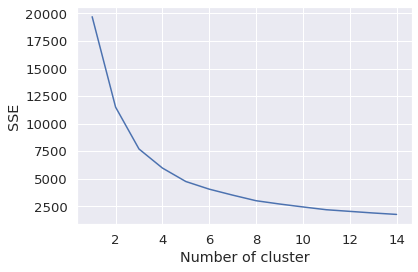

In [ ]:
#Finding the K for K-Means
sse = {}
for k in range(1, 15):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(X)
    sse[k] = kmeans.inertia_
    # Inertia: Sum of distances of samples to their closest cluster center

plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")
plt.show()

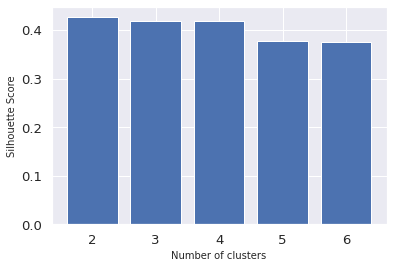

In [ ]:
#optimum number for K
silhouette_scores = []

for n_cluster in range(2, 7):
    silhouette_scores.append( 
        silhouette_score(X, KMeans(n_clusters = n_cluster).fit_predict(X))) 
    
# Plotting a bar graph to compare the results 
k = [2, 3, 4, 5, 6] 
plt.bar(k, silhouette_scores) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show() 

Walaupun berbeda tipis. Namun secara objektif berdasarkan hasil Silhouette Score, **nilai K optimum terdapat pada K = 2**

In [ ]:
#fit K = 2 to dataframe
kmean = KMeans(2)
kmean.fit(scaled)
labels=kmean.labels_

In [ ]:
custsegment = pd.concat([X_first, pd.DataFrame({'cluster':labels})], axis=1)
custsegment.head()

,Tenure,CityTier,WarehouseToHome,HourSpendOnApp,NumberOfDeviceRegistered,SatisfactionScore,NumberOfAddress,Complain,OrderAmountHikeFromlastYear,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount,PreferredLoginDevice_Mobile Phone,PreferredLoginDevice_Phone,PreferredPaymentMode_COD,PreferredPaymentMode_Cash on Delivery,PreferredPaymentMode_Credit Card,PreferredPaymentMode_Debit Card,PreferredPaymentMode_E wallet,PreferredPaymentMode_UPI,Gender_Male,PreferedOrderCat_Grocery,PreferedOrderCat_Laptop & Accessory,PreferedOrderCat_Mobile,PreferedOrderCat_Mobile Phone,PreferedOrderCat_Others,MaritalStatus_Married,MaritalStatus_Single,cluster
0,4.0,3,6.0,3.0,3,2,9,1,11.0,1.0,1.0,5.0,159.93,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0
1,0.0,3,15.0,2.0,4,5,8,0,23.0,0.0,1.0,3.0,134.07,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,1,0
2,0.0,1,22.0,3.0,5,5,2,1,22.0,4.0,6.0,7.0,139.19,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,1
3,11.0,1,6.0,3.0,4,3,10,1,13.0,0.0,1.0,0.0,153.81,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,1
4,0.0,1,11.0,2.0,3,3,2,1,13.0,2.0,2.0,2.0,134.41,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,1,1


# 9. Model Evaluation

### Supervised Model

Berdasarkan hasil riset, model yang menggunakan hyperparameter Random Forest justru menghasilkan performa yang tidak lebih baik, dibandingkan hasil Base Model Random Forest. Rinciannya sebagai berikut:

Hyperparameter Model
* Recall : 63%
* True Positive : 100
* False Positive : 16
* True Negative : 770
* False Negative : 58

Sedangkan Base Model
* Recall : 86%
* True Positive : 136
* False Positive : 9
* True Negative : 777
* False Negative : 22

Alasan kenapa kita mengambil nilai **Recall** karena kita mau menghindari False Negative (Mereka yang Churn tapi diprediksi tidak Churn).

### Unsupervised Model (Clustering)

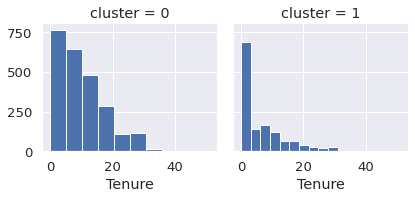

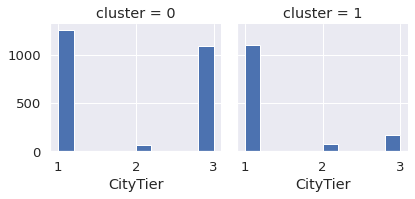

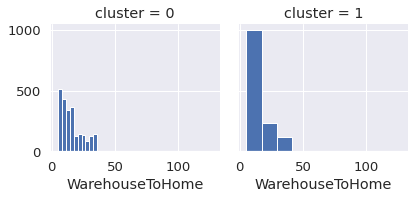

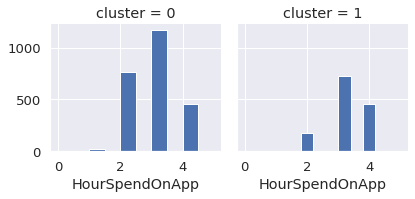

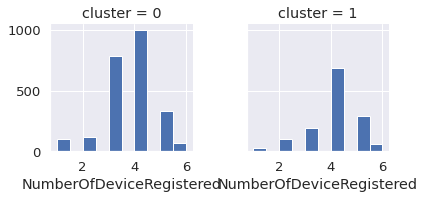

...

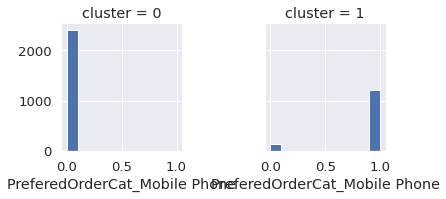

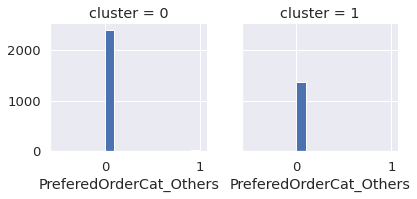

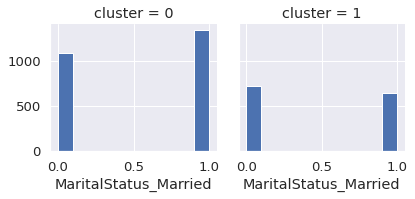

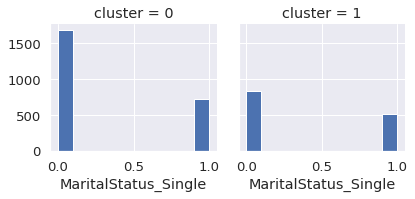

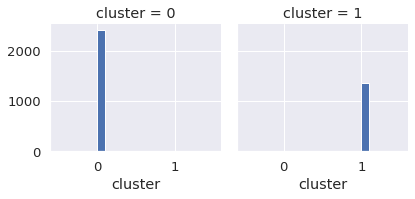

In [ ]:
#visualize interpretation for each cluster
for i in custsegment:
    grid= sns.FacetGrid(custsegment, col='cluster')
    grid.map(plt.hist, i)

Karena ternyata untuk cluster dengan K = 2 tidak terlalu nampak perbedaannya. Kita akan mencoba untuk mengganti nilai K menjadi 3

In [ ]:
#fit K = 3 to dataframe
kmean = KMeans(3)
kmean.fit(scaled)
labels=kmean.labels_

In [ ]:
custsegment2 = pd.concat([X_first, pd.DataFrame({'cluster':labels})], axis=1)
custsegment2.head()

,Tenure,CityTier,WarehouseToHome,HourSpendOnApp,NumberOfDeviceRegistered,SatisfactionScore,NumberOfAddress,Complain,OrderAmountHikeFromlastYear,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount,PreferredLoginDevice_Mobile Phone,PreferredLoginDevice_Phone,PreferredPaymentMode_COD,PreferredPaymentMode_Cash on Delivery,PreferredPaymentMode_Credit Card,PreferredPaymentMode_Debit Card,PreferredPaymentMode_E wallet,PreferredPaymentMode_UPI,Gender_Male,PreferedOrderCat_Grocery,PreferedOrderCat_Laptop & Accessory,PreferedOrderCat_Mobile,PreferedOrderCat_Mobile Phone,PreferedOrderCat_Others,MaritalStatus_Married,MaritalStatus_Single,cluster
0,4.0,3,6.0,3.0,3,2,9,1,11.0,1.0,1.0,5.0,159.93,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,1
1,0.0,3,15.0,2.0,4,5,8,0,23.0,0.0,1.0,3.0,134.07,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,1,1
2,0.0,1,22.0,3.0,5,5,2,1,22.0,4.0,6.0,7.0,139.19,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0
3,11.0,1,6.0,3.0,4,3,10,1,13.0,0.0,1.0,0.0,153.81,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,1
4,0.0,1,11.0,2.0,3,3,2,1,13.0,2.0,2.0,2.0,134.41,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,1,0


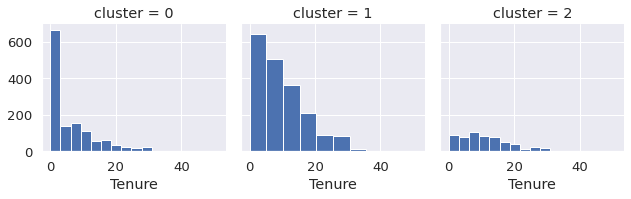

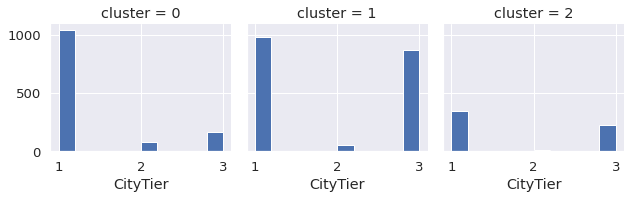

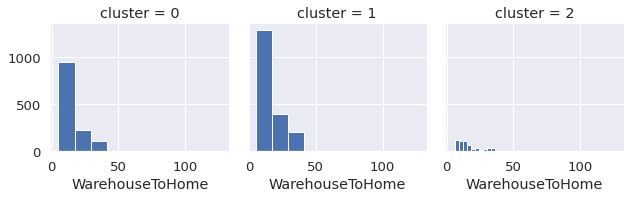

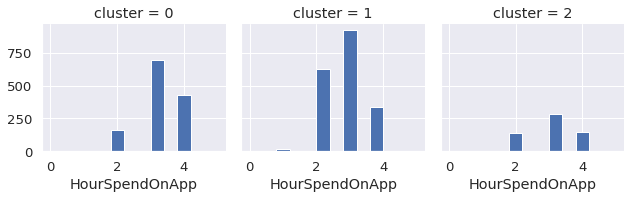

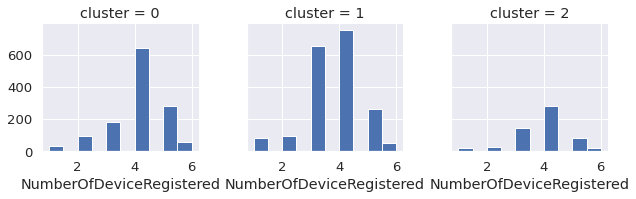

...

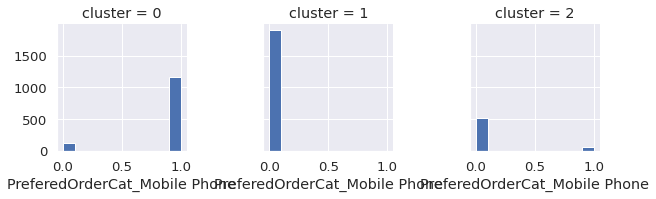

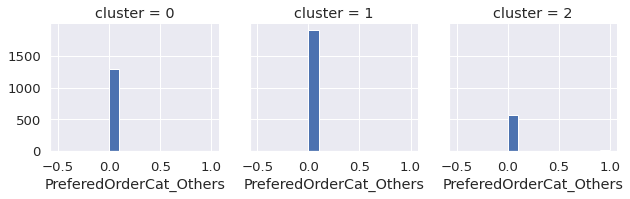

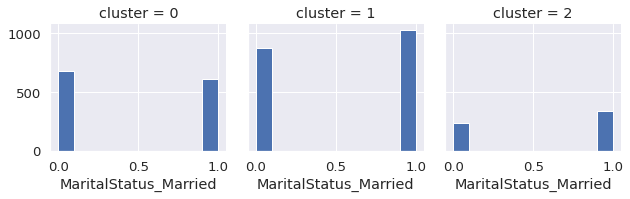

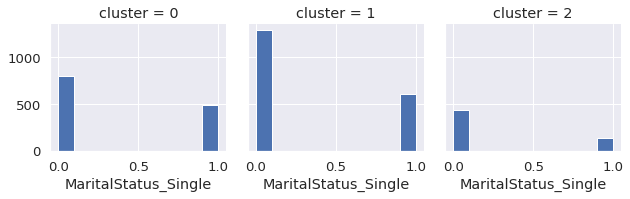

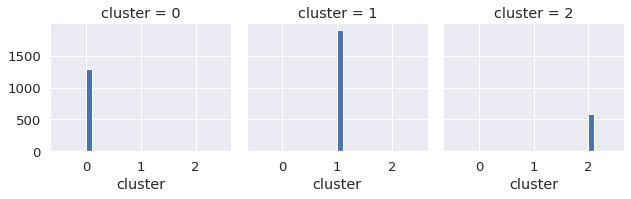

In [ ]:
#visualize interpretation for each cluster
for i in custsegment2:
    grid= sns.FacetGrid(custsegment2, col='cluster')
    grid.map(plt.hist, i)

Melalui K-Means Clustering dapat kita lihat bahwa

* Cluster 0 merupakan pelanggan kategori P3, yakni para pencari promo. Dapat dilihat dari Hour Spend yang merupakan tertinggi kedua setelah Cluster 1, jumlah  Cashback Amount, hingga Order Count yang cenderung diangka 1-3 order saja (sementara saat dataset ini dipublikasikan) dengan barang favoritnya adalah Mobile Phone


* Cluster 1 merupakan pelanggan rata-rata pada umumnya. Dapat dilihat dari grafiknya secara umum yang kritis (memberikan complain), dan Day Since Last Order yang terbilang standar, Coupon Used yang artinya senang memakai promo, HourSpendonApp yang cukup tinggi, dll


* Cluster 2 merupakan pelanggan yang loyal. Dapat dilihat dari jumlah Order Count & Days Since Last Order yang cenderung merepresentasikan bahwa mereka termasuk customer yang cukup sering repeat order

# 10. Model Saving

In [ ]:
import joblib

#supervised model
joblib.dump(pipe1, 'my_model.pkl')

['my_model.pkl']

# 11. Model Inference

In [ ]:
#datahead
X_first.head()

,Tenure,CityTier,WarehouseToHome,HourSpendOnApp,NumberOfDeviceRegistered,SatisfactionScore,NumberOfAddress,Complain,OrderAmountHikeFromlastYear,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount,PreferredLoginDevice_Mobile Phone,PreferredLoginDevice_Phone,PreferredPaymentMode_COD,PreferredPaymentMode_Cash on Delivery,PreferredPaymentMode_Credit Card,PreferredPaymentMode_Debit Card,PreferredPaymentMode_E wallet,PreferredPaymentMode_UPI,Gender_Male,PreferedOrderCat_Grocery,PreferedOrderCat_Laptop & Accessory,PreferedOrderCat_Mobile,PreferedOrderCat_Mobile Phone,PreferedOrderCat_Others,MaritalStatus_Married,MaritalStatus_Single
0,4.0,3,6.0,3.0,3,2,9,1,11.0,1.0,1.0,5.0,159.93,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1
1,0.0,3,15.0,2.0,4,5,8,0,23.0,0.0,1.0,3.0,134.07,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,1
2,0.0,1,22.0,3.0,5,5,2,1,22.0,4.0,6.0,7.0,139.19,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1
3,11.0,1,6.0,3.0,4,3,10,1,13.0,0.0,1.0,0.0,153.81,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1
4,0.0,1,11.0,2.0,3,3,2,1,13.0,2.0,2.0,2.0,134.41,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,1


In [ ]:
'''
Pelanggan A
Tenure : 6.0
CityTier : 3
WarehousetoHome: 5.0
HourSpendonApp : 3.0
NumberofDeviceRegistered : 4.0
Satifaction : 4
NumberofAddress : 5
Complain : 0
OrderAmountHike : 21.0
CouponUsed : 3.0
Order Count : 3.0
DaySinceLastORder : 14.0
Cashback Amount : 115.00
Preferred Login Device : Mobile Phone (1, 0)
Payment Methods : Debit Card (0, 0, 0, 1, 0, 0)
Gender : Male (1)
Preferred ORder Cat : Mobile Phone (0, 0, 0, 1, 0)
Marital Stat : Single (0, 1)
'''
pelanggan = np.array([[6.0, 3, 5.0, 3.0, 4.0, 4, 5, 0, 21.0, 3.0, 3.0, 14.0, 115.00, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1]])
pred = pipe1.predict(pelanggan)
if pred == 1:
    print(">> More likely to Churn")
else:
    print(">> Less likely to Churn")

>> Less likely to Churn


# 12. Conclusion

1. Melalui supervised model, kita mendapatkan model terbaik pada parameter ```pipe1``` dengan nilai Recall sebesar 88%. ```Pipe1``` dibuat menggunakan StandardScaler dan Base Model dari Random Forest. Alasan menggunakan ```pipe1``` yang merupakan Base Model atas dasar hasil Hyperparamter yang justru memberikan hasil Recall lebih buruk yakni diangka 63%. Model juga sudah disave agar dapat dideploy menggunakan joblib dengan nama file ```my_model.pkl```


2. Hasil dari Unsupervised Model menghasilkan 3 Cluster dengan rincian :
    * Cluster 0 merupakan pelanggan kategori P3, yakni para pencari promo. Dapat dilihat dari Hour Spend yang merupakan tertinggi kedua setelah Cluster 1, jumlah  Cashback Amount, hingga Order Count yang cenderung diangka 1-3 order saja (sementara saat dataset ini dipublikasikan) dengan barang favoritnya adalah Mobile Phone
    * Cluster 1 merupakan pelanggan rata-rata pada umumnya. Dapat dilihat dari grafiknya secara umum yang kritis (memberikan complain), dan Day Since Last Order yang terbilang standar, Coupon Used yang artinya senang memakai promo, HourSpendonApp yang cukup tinggi, dll
    * Cluster 2 merupakan pelanggan yang loyal. Dapat dilihat dari jumlah Order Count & Days Since Last Order yang cenderung merepresentasikan bahwa mereka termasuk customer yang cukup sering repeat order

3. Melalui kesimpulan nomor 2 dapat menghasilkan saran kepada stakeholder, bahwa dalam perencanaan strategi marketing bisa mengacu kepada cluster tadi. Tinggal menentukan tujuan marketing apa yang ingin dicapai dari ketiga karakter customer yang kita punya.
